## Evaluating Topic Models and Identifying Uncertainty Related Keywords

In [6]:
import os
os.chdir("../../..")
print(os.getcwd())
from pathlib import Path
import gensim
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis
import pandas as pd
import altair as alt
from nlp.topic_models.lda.stream_corpus import StreamingCorpus
from utils import check_and_create_dir

/Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index


In [2]:
# Config
from IPython.display import display, HTML
pyLDAvis.enable_notebook()

# HTML save dir
lda_viz_save_dir = Path("nlp/topic_models/analytics/lda_vizzes")
check_and_create_dir(lda_viz_save_dir)

Directory already exists!


### 1. Gensim LDA
#### ```U-Mass Coherence Score``` against ```K (No. of Topics)```

In [3]:
# Plot coherence against K
umass = []
K = []

In [4]:
# These are common across all models (Trained on entire corpus)
raw_data_dir = 'nlp/topic_models/data/processed_reddit'

# Load Corpus
file_paths = list(Path(str(raw_data_dir)).rglob("*.csv"))
corpus = StreamingCorpus(
    csv_file_paths=file_paths,
    load_from_saved_fp='nlp/topic_models/models/lda/lda_run_2022-02-16 23:50:42.565349/dictionary.txt'
)
# Load Dictionary
dict = corpus.corpus_dict

[2022-02-20 03:02:28] INFO     Constructing Dictionary                    ]8;id=20497;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=351254;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#47\47]8;;\

                      INFO     Dictionary loaded: Dictionary(41259 unique ]8;id=190032;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=638943;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#55\55]8;;\
                               tokens: ['_', '__', '____id____', '__cb',                     
                               '__cf_chl_jschl_tk__']...)                                    

#### 1.1 Reddit Unigram Corpus (K = 10)
* ```U_mass Coherence``` = -2.0598

In [8]:
# Load Dictionary
# Load models
model_10 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 19:37:40.104339/lda_model_10_-2.0598494174211925.lda'
)

[2022-02-20 02:31:35] INFO     loading LdaModel object from                      ]8;id=24568;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=446707;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=556928;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=389203;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute state to None           ]8;id=693866;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=816201;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=971869;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=451322;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=273823;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=511096;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=393219;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=319750;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=258919;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=249497;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=435220;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=939179;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a.state                                                       

In [9]:
# Prepare LDA Viz
viz_10 = gensimvis.prepare(model_10, corpus, dict)
pyLDAvis.save_html(viz_10, str(lda_viz_save_dir / 'lda_10_result.html'))

[2022-02-20 02:31:37] INFO     Streaming input text to create BOW Corpus  ]8;id=220288;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=163351;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#73\73]8;;\

[2022-02-20 02:34:57] INFO     End of StreamingCorpus                     ]8;id=801446;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=427674;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#83\83]8;;\

[2022-02-20 02:35:13] INFO     Streaming input text to create BOW Corpus  ]8;id=890834;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=221574;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#73\73]8;;\

[2022-02-20 02:53:10] INFO     End of StreamingCorpus                     ]8;id=615149;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=663263;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#83\83]8;;\

/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/pyLDAvis/_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualen

ValueError: fileobj should be a filename or a writable file

In [5]:
# Visualise
display(HTML(str(lda_viz_save_dir / 'lda_10_result.html')))

#### 1.2 Reddit Unigram Corpus (K = 20)
* ```U_mass Coherence``` = -2.4073

In [13]:
# Load models
model_20 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 23:50:42.565349/lda_model_20_-2.4072564582036913.lda'
)

[2022-02-20 02:56:09] INFO     loading LdaModel object from                      ]8;id=660358;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=541756;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=741900;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=756255;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute dispatcher to None      ]8;id=497510;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=115720;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=646083;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=620999;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=148187;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=975718;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=870946;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=664136;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=446564;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=560869;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=479031;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=728800;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a.state                                                       

In [14]:
# Prepare LDA Viz
viz_20 = gensimvis.prepare(model_20, corpus, dict)
pyLDAvis.save_html(viz_20, str(lda_viz_save_dir / 'lda_20_result.html'))

[2022-02-20 02:56:14] INFO     Streaming input text to create BOW Corpus  ]8;id=440286;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=218078;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#73\73]8;;\

KeyboardInterrupt: 

In [ ]:
# Visualise
display(HTML(str(lda_viz_save_dir / 'lda_20_result.html')))

#### 1.3 Reddit Unigram Corpus (K = 30)
* ```U_mass Coherence``` = -2.529

In [ ]:
# Load models
model_30 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 23:50:42.565349/lda_model_30_-2.5285975052666823.lda'
)

In [ ]:
# Prepare LDA Viz
viz_30 = gensimvis.prepare(model_30, corpus, dict)
pyLDAvis.save_html(viz_30, 'lda_30_result.html')

In [ ]:
# Visualise
display(HTML(lda_viz_save_dir / 'lda_30_result.html'))

#### 1.4 Reddit Unigram Corpus (K = 40)
* ```U_mass Coherence``` = -2.861

In [ ]:
# Load models
model_40 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 23:50:42.565349/lda_model_40_-2.8613551344890014.lda'
)

In [ ]:
# Prepare LDA Viz
viz_40 = gensimvis.prepare(model_40, corpus, dict)
pyLDAvis.save_html(viz_40, 'lda_40_result.html')

In [ ]:
# Visualise
display(HTML(lda_viz_save_dir / 'lda_40_result.html'))

#### 1.5 Reddit Unigram Corpus (K = 50)
* ```U_mass Coherence``` = -2.946

In [6]:
# Load models
model_50 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-17 02:30:37.967859/lda_model_50_-2.9458478905345857.lda'
)

[2022-02-20 03:02:42] INFO     loading LdaModel object from                      ]8;id=586868;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=491846;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=736456;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=928055;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute id2word to None         ]8;id=468957;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=716415;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=375155;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=607550;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=170323;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=155923;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=123326;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=955063;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=984194;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=277859;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=469539;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=983041;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a.state                                                       

In [7]:
# Prepare LDA Viz
viz_50 = gensimvis.prepare(model_50, corpus, dict)
pyLDAvis.save_html(viz_50, str(lda_viz_save_dir / 'lda_50_result.html'))

[2022-02-20 03:02:43] INFO     Streaming input text to create BOW Corpus  ]8;id=27318;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=346154;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#73\73]8;;\

[2022-02-20 03:06:03] INFO     End of StreamingCorpus                     ]8;id=554526;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=147456;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#84\84]8;;\

[2022-02-20 03:06:34] INFO     Streaming input text to create BOW Corpus  ]8;id=771671;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=968264;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#73\73]8;;\

[2022-02-20 03:27:32] INFO     End of StreamingCorpus                     ]8;id=34065;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=689555;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#84\84]8;;\

/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/pyLDAvis/_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualen

In [9]:
# Visualise
display(HTML(str(lda_viz_save_dir / 'lda_50_result.html')))

#### 1.6 Reddit Unigram Corpus (K = 100)
* ```U_mass Coherence``` = -4.099

In [10]:
# Load models
model_100 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 14:35:28.242947/lda_model_100_-4.09886666032905.lda'
)

[2022-02-20 03:37:46] INFO     loading LdaModel object from                      ]8;id=725033;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=484468;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             

                      INFO     loading expElogbeta from                          ]8;id=318434;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=319713;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             
                               .expElogbeta.npy with mmap=None                               

                      INFO     setting ignored attribute state to None           ]8;id=859532;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=825780;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=82287;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=945870;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=678402;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=438537;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=306569;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=269475;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             

                      INFO     loading LdaState object from                      ]8;id=801904;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=905689;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             
                               .state                                                        

                      INFO     loaded                                            ]8;id=590068;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=656367;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             
                               .state                                                        

In [11]:
# Prepare LDA Viz
viz_100 = gensimvis.prepare(model_100, corpus, dict)
pyLDAvis.save_html(viz_100, str(lda_viz_save_dir / 'lda_100_result.html'))

[2022-02-20 03:38:11] INFO     Streaming input text to create BOW Corpus  ]8;id=695168;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=797277;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#73\73]8;;\

[2022-02-20 03:41:30] INFO     End of StreamingCorpus                     ]8;id=799903;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=692812;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#84\84]8;;\

[2022-02-20 03:42:21] INFO     Streaming input text to create BOW Corpus  ]8;id=342660;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=751719;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#73\73]8;;\

[2022-02-20 04:43:41] INFO     End of StreamingCorpus                     ]8;id=396691;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=467872;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#84\84]8;;\

/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/pyLDAvis/_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  default_term_info = default_term_info.sort_values(
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/past/builtins/misc.py:45: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import reload
/Users/christopherliew/Library/Caches/pypoetry/virtualen

In [12]:
# Visualise
display(HTML(str(lda_viz_save_dir / 'lda_100_result.html')))

#### 1.7 Reddit Unigram Corpus (K = 200)
* ```U_mass Coherence``` = -4.548

In [ ]:
# Load models
model_200 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 14:35:28.242947/lda_model_200_-4.547866172320138.lda'
)

In [ ]:
# Prepare LDA Viz
viz_200 = gensimvis.prepare(model_200, corpus, dict)
pyLDAvis.save_html(viz_200, 'lda_200_result.html')

In [ ]:
# Visualise
display(HTML(lda_viz_save_dir / 'lda_200_result.html'))

#### 1.8 Reddit Unigram Corpus (K = 300)
* ```U_mass Coherence``` = -4.675

In [ ]:
# Load models
model_300 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 14:35:28.242947/lda_model_300_-4.675032900840325.lda'
)

In [ ]:
# Prepare LDA Viz
viz_300 = gensimvis.prepare(model_300, corpus, dict)
pyLDAvis.save_html(viz_300, 'lda_300_result.html')

In [ ]:
# Visualise
display(HTML(lda_viz_save_dir / 'lda_300_result.html'))

### 2. Top2Vec
#### 2.1 Sampled Corpus (5%)
**UMAP Normal Memory**

In [3]:
from top2vec import Top2Vec

In [7]:
t2v5_model = Top2Vec.load("nlp/topic_models/models/top2vec/top2vec_learn_doc2vec_5")

In [8]:
print(f"Number of Topics: {t2v5_model.get_num_topics()}")

Number of Topics: 2770


**Identify Topics Related to Price Uncertainty**

In [12]:
topic_words, word_scores, topic_scores, topic_nums = (
    t2v5_model.search_topics(
        keywords=["uncertainty", "price"],
        num_topics=10
    )
)

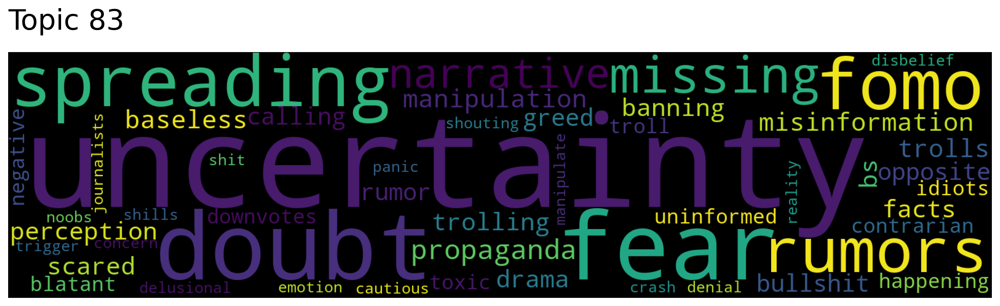

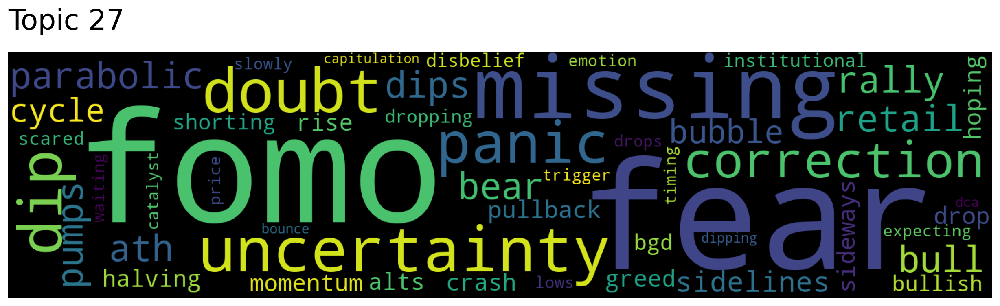

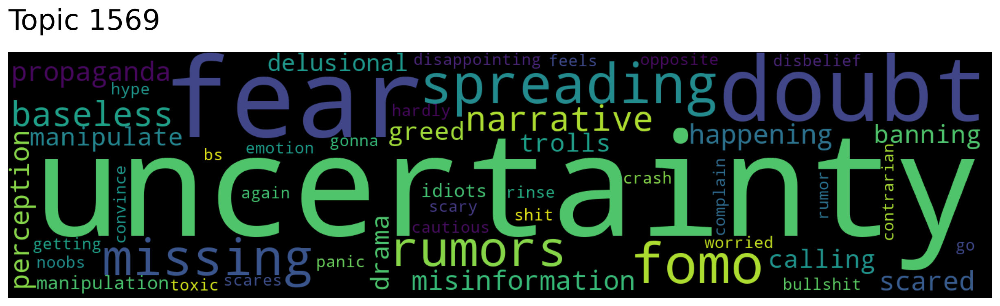

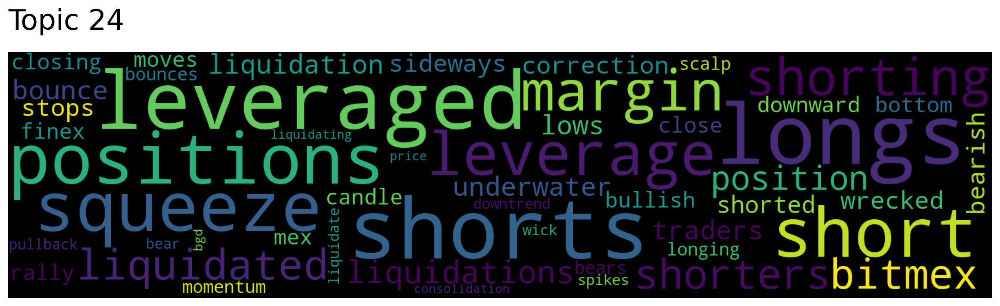

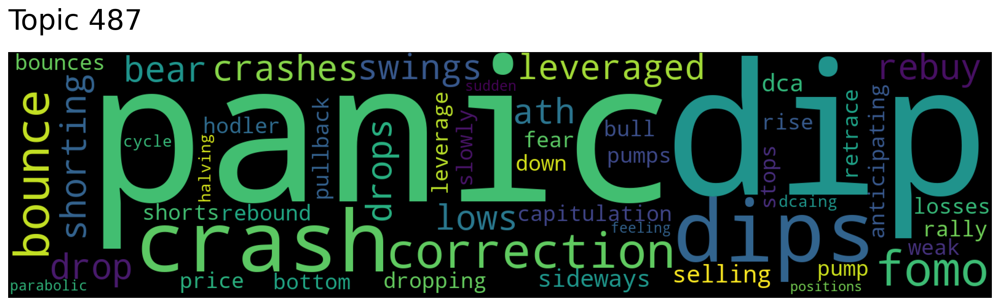

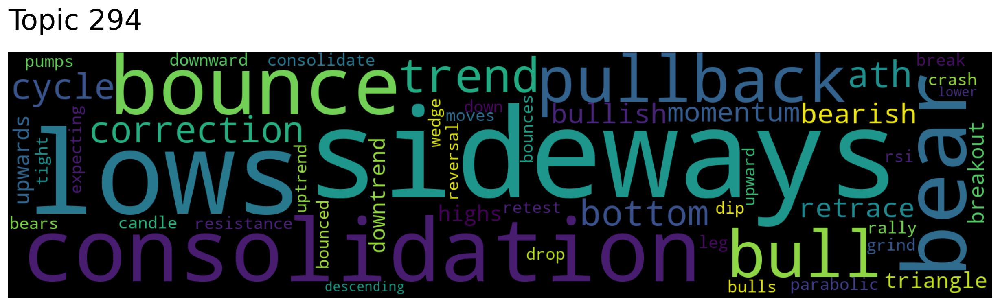

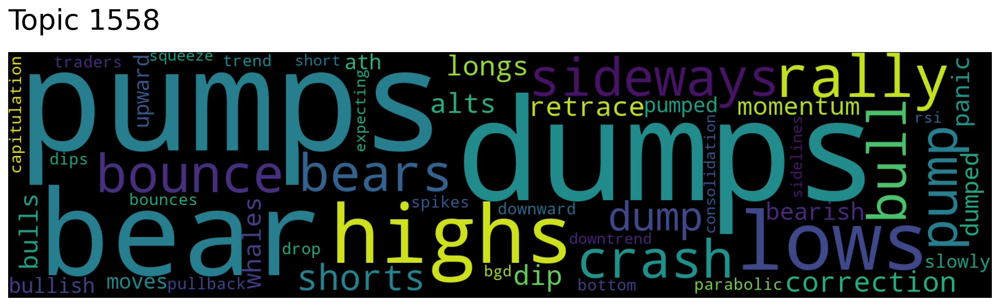

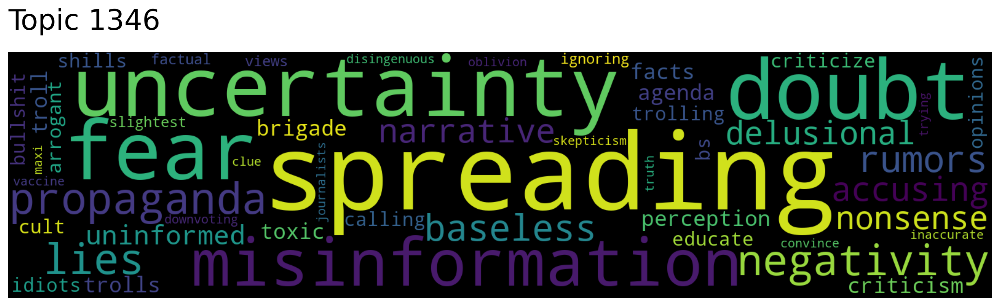

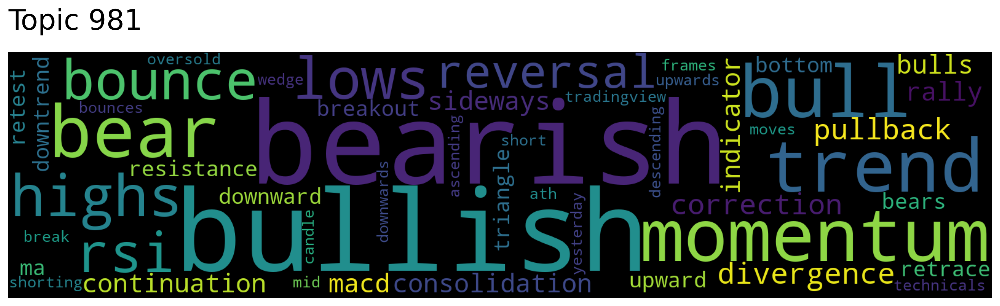

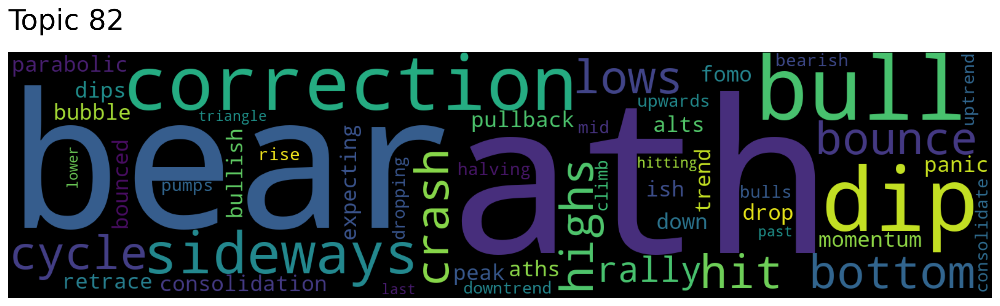

In [13]:
# Visualise in Word Clouds
for topic in topic_nums:
    t2v5_model.generate_topic_wordcloud(topic)

**Identify Topics Related to Policy Uncertainty**

In [14]:
topic_words, word_scores, topic_scores, topic_nums = (
    t2v5_model.search_topics(
        keywords=["uncertainty", "policy"],
        num_topics=10
    )
)

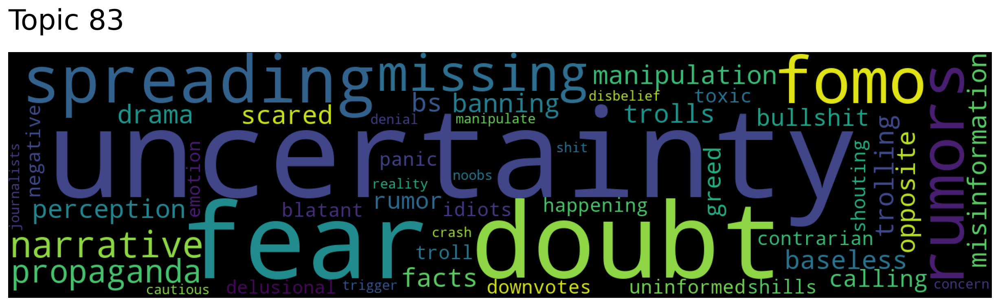

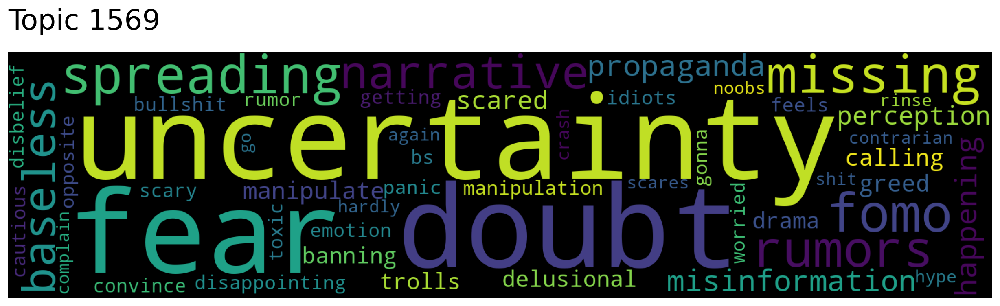

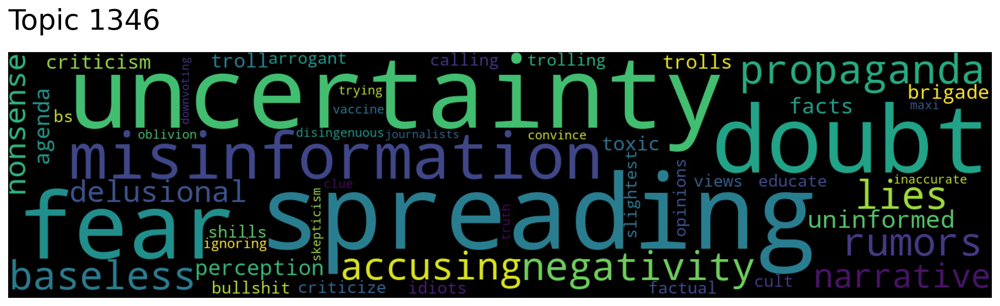

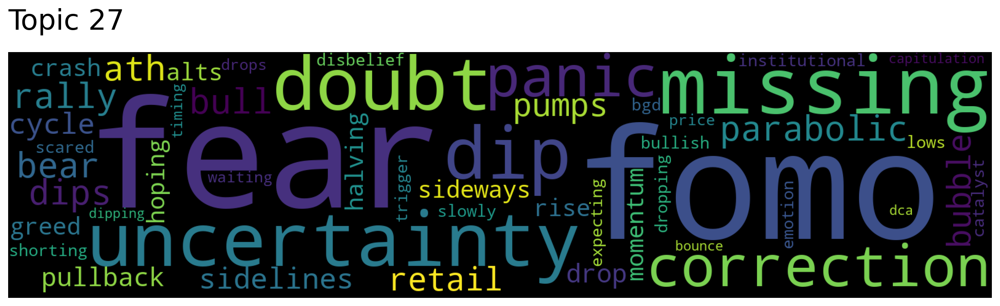

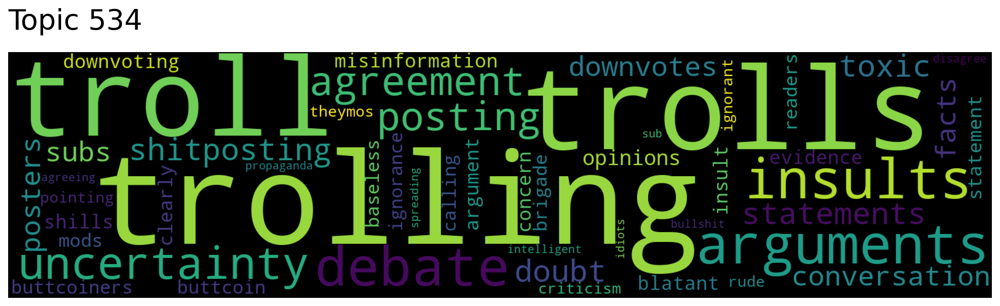

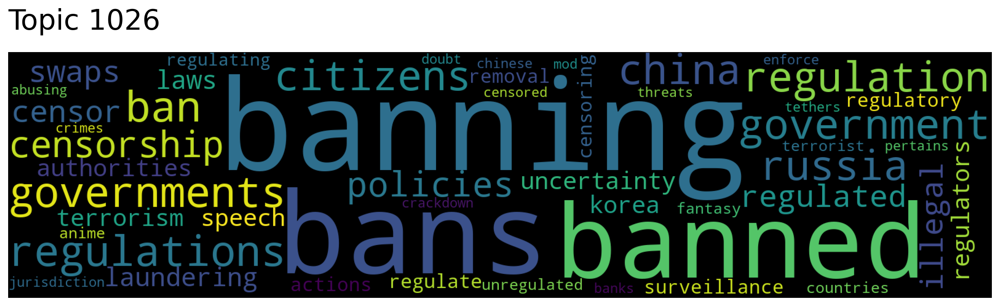

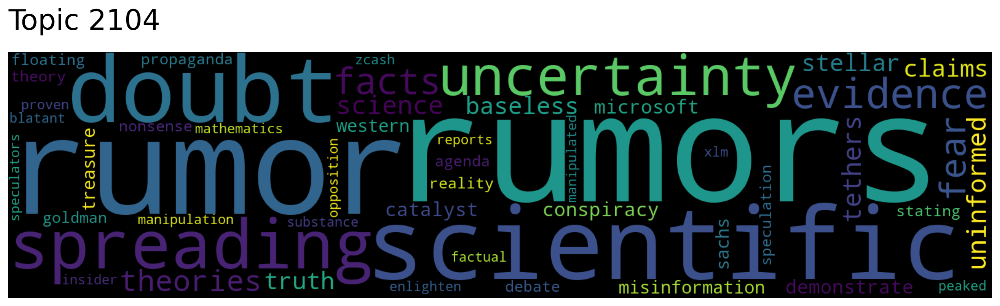

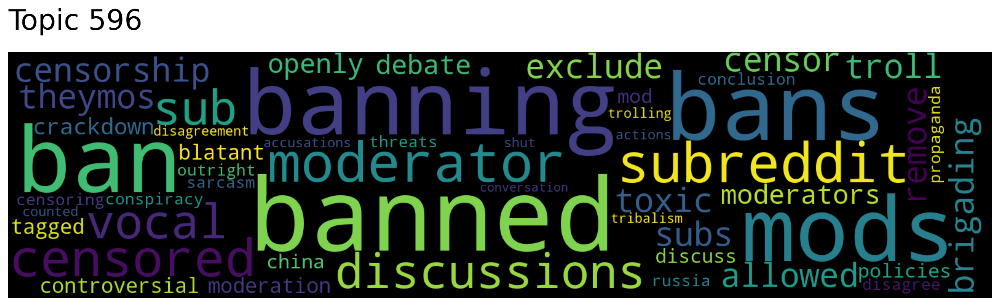

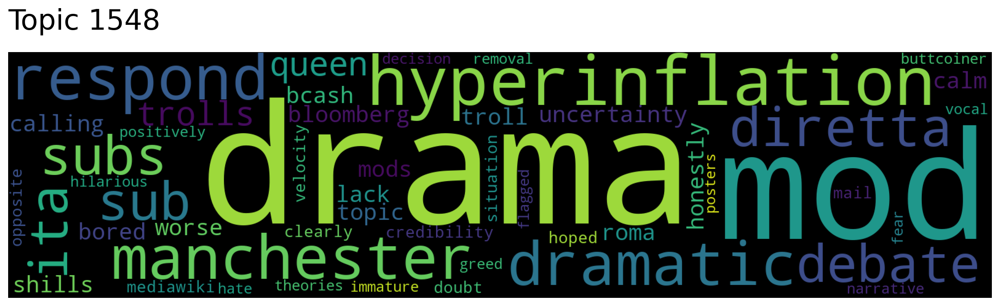

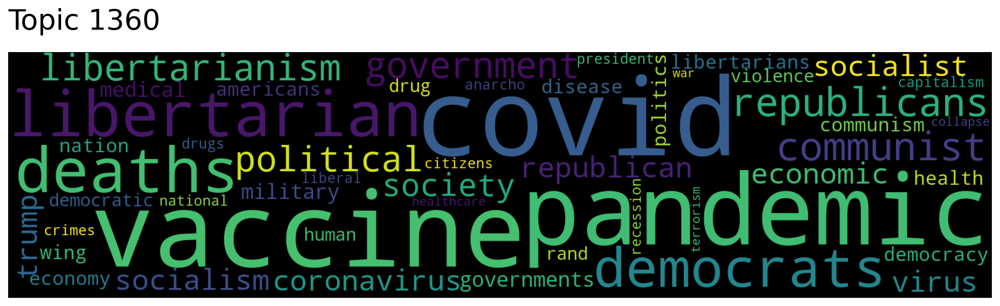

In [16]:
# Visualise in Word Clouds
for topic in topic_nums:
    t2v5_model.generate_topic_wordcloud(topic)

#### 2.2 Sampled Corpus (10%)

In [17]:
t2v10_model = Top2Vec.load("nlp/topic_models/models/top2vec/top2vec_learn_doc2vec_10")

In [19]:
print(f"Number of Topics: {t2v10_model.get_num_topics()}")

Number of Topics: 4228


**Identify Topics Related to Price Uncertainty**

In [20]:
topic_words, word_scores, topic_scores, topic_nums = (
    t2v10_model.search_topics(
        keywords=["uncertainty", "price"],
        num_topics=10
    )
)

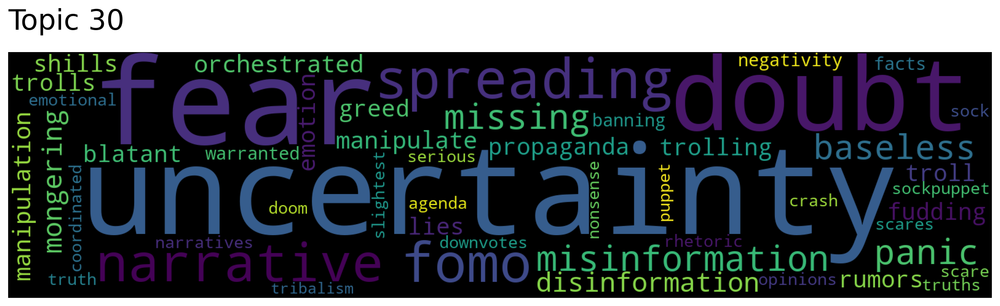

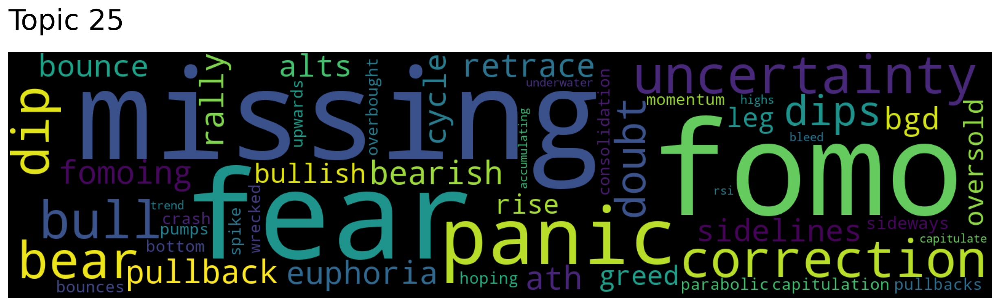

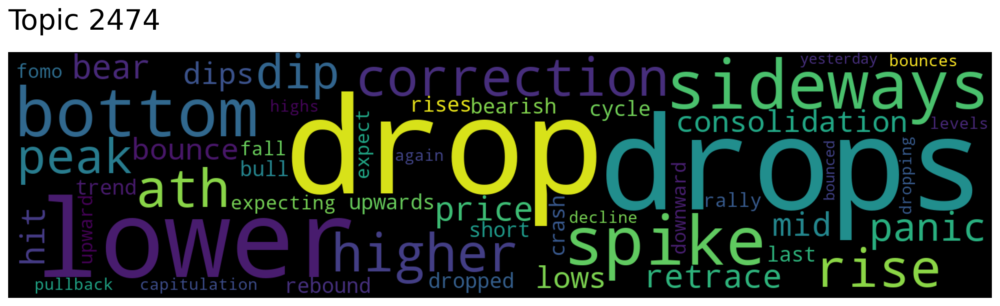

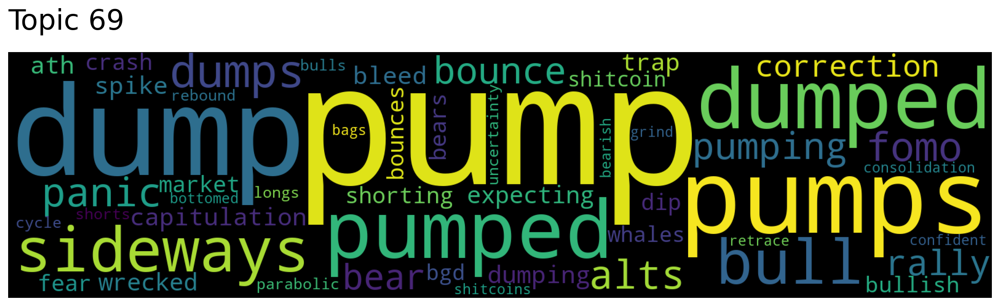

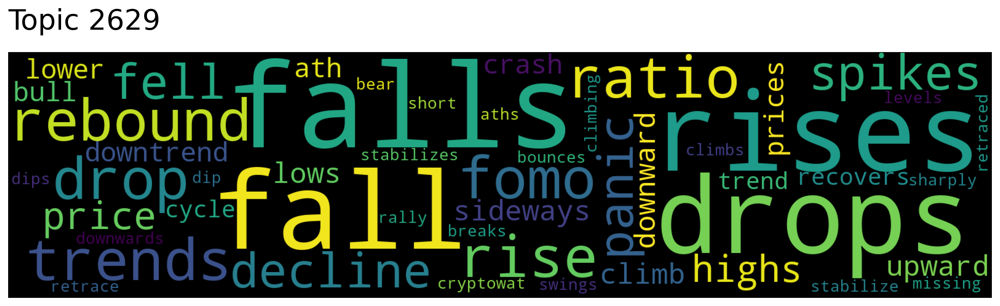

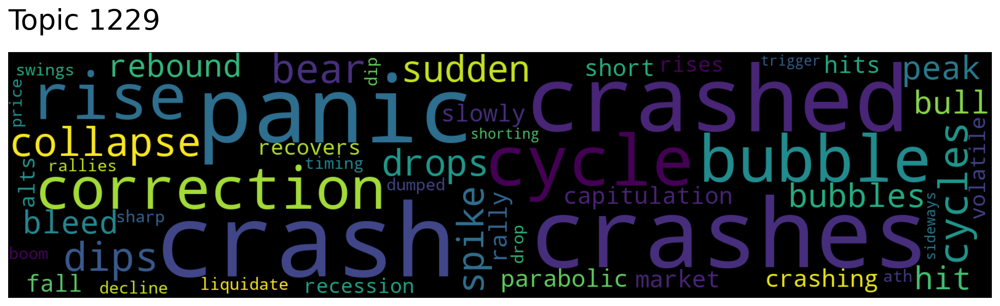

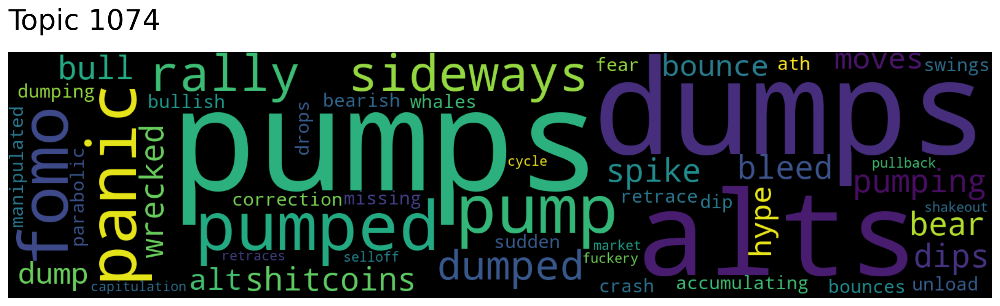

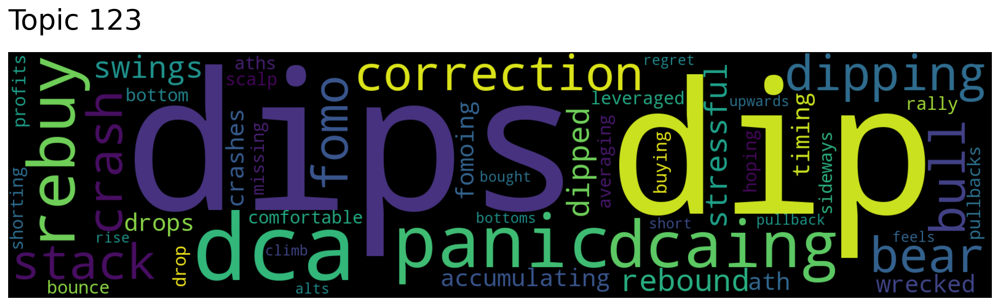

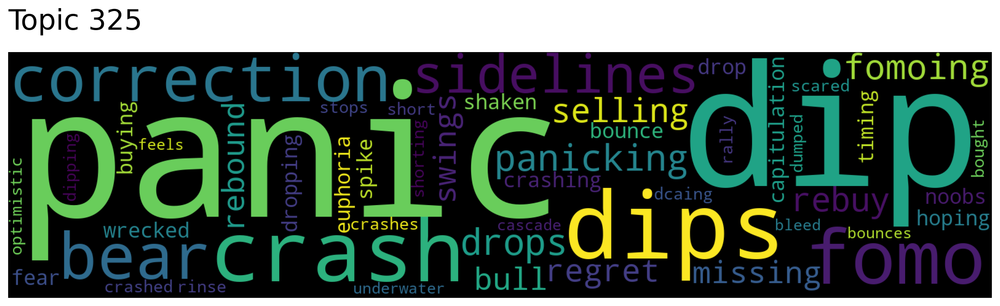

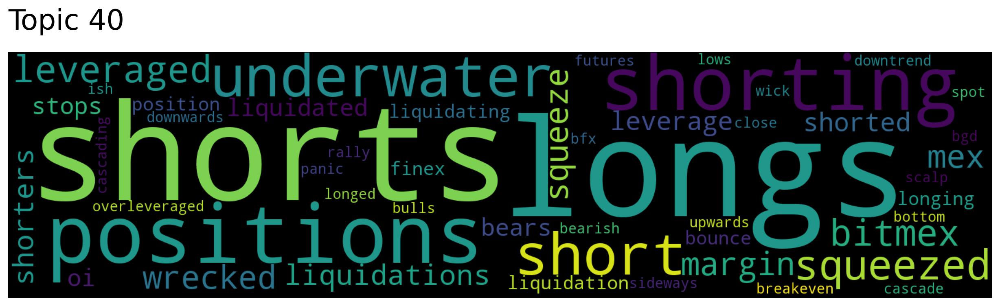

In [21]:
# Visualise in Word Clouds
for topic in topic_nums:
    t2v10_model.generate_topic_wordcloud(topic)

**Identify Topics Related to Policy Uncertainty**

In [22]:
topic_words, word_scores, topic_scores, topic_nums = (
    t2v10_model.search_topics(
        keywords=["uncertainty", "policy"],
        num_topics=10
    )
)

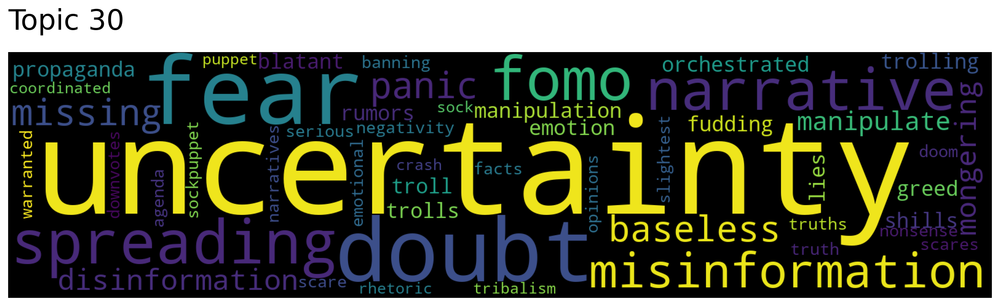

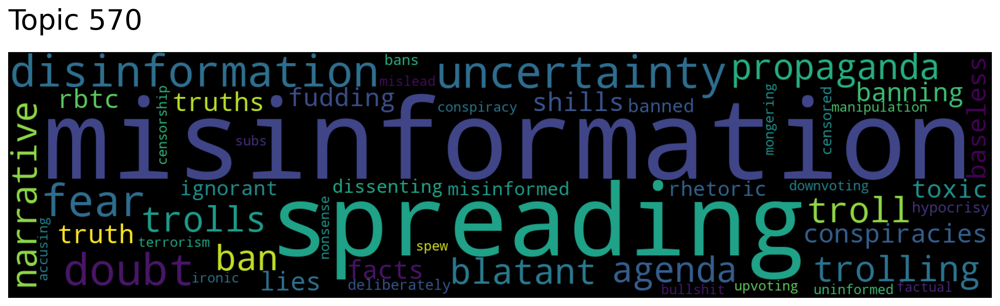

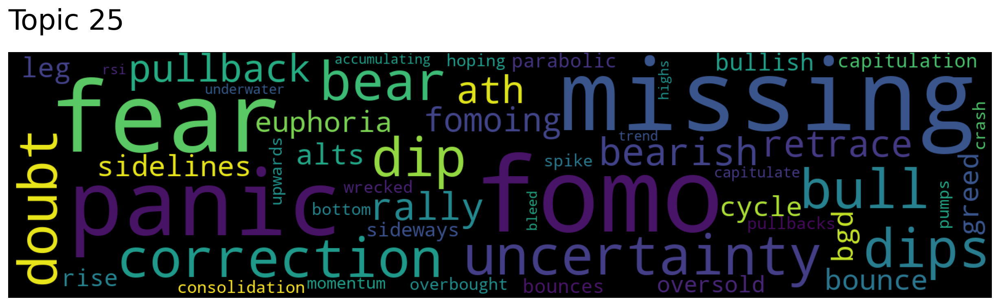

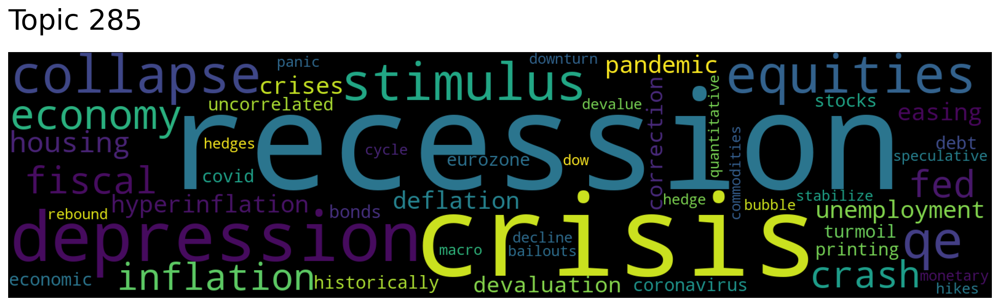

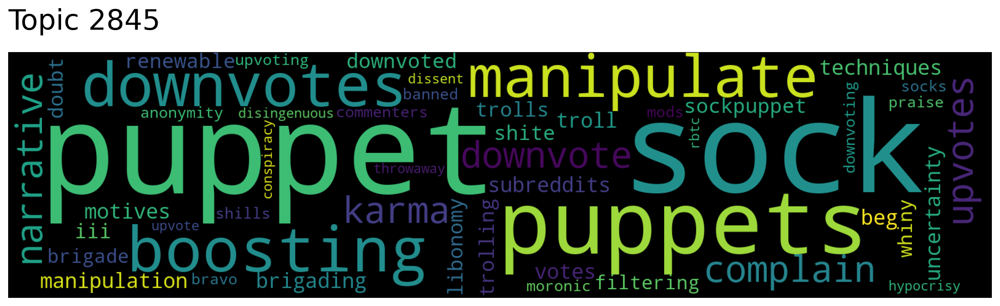

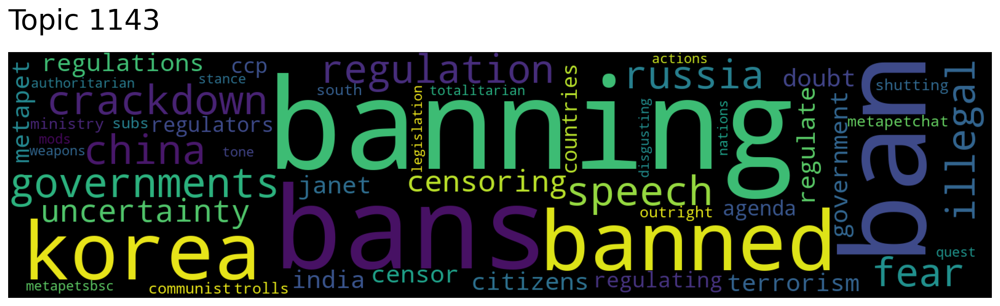

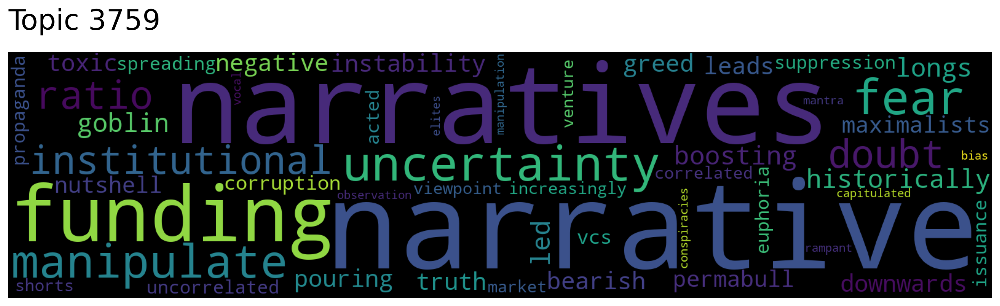

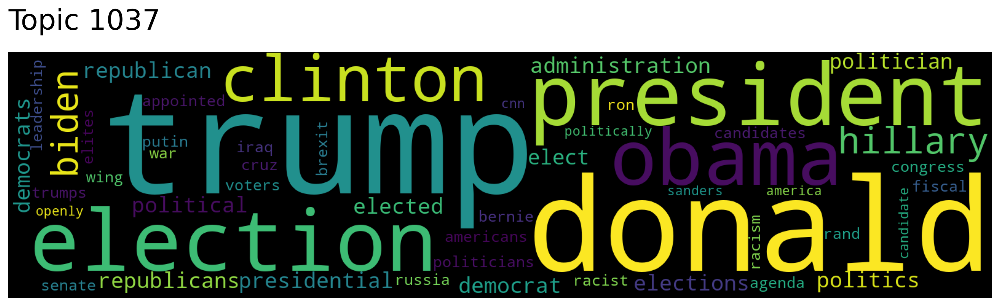

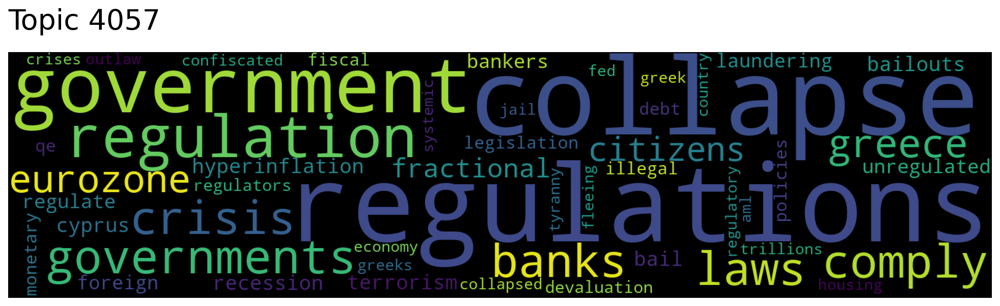

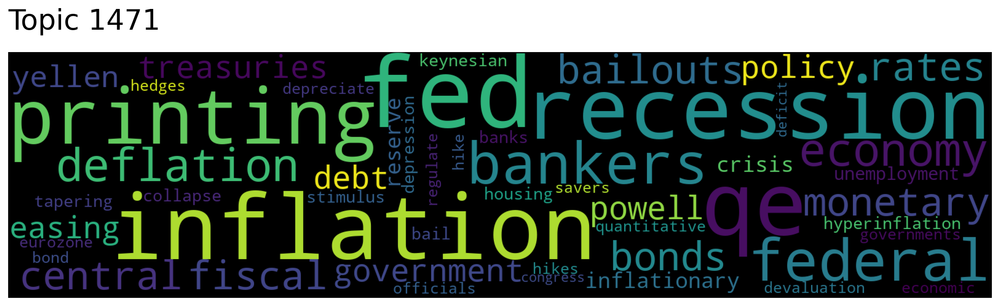

In [23]:
# Visualise in Word Clouds
for topic in topic_nums:
    t2v10_model.generate_topic_wordcloud(topic)